In [1]:
%load_ext autoreload
%autoreload 2
import dotenv
dotenv.load_dotenv()

True

In [2]:
import os
from experimentator import build_experiment

experiment_id = '20221101_125058.223524'
folder = os.path.join(os.environ['RESULTS_FOLDER'], "ballstate", experiment_id)
exp = build_experiment(os.path.join(folder, 'config.py'))

/home/gva/repositories/dataset_utilities/dataset_utilities/calib.py:5: UserWarning: Deprecated import. use `from deepsport_utilities.calib` instead of `from dataset_utilities.calib`
  warnings.warn("Deprecated import. use `from deepsport_utilities.calib` instead of `from dataset_utilities.calib`")


ball_states_dataset.pickle found in /scratch/gva/ball_states_dataset.pickle
ballistic_ball_views.pickle found in /scratch/gva/ballistic_ball_views.pickle
loading '/home/gva/repositories/deepsport/results/ballstate/20221101_125058.223524/0040_weights'


In [3]:
from mlworkflow import PickledDataset, TransformedDataset, AugmentedDataset
from experimentator import find
ds = PickledDataset(find("evaluation_ball_views_dataset.pickle"))

def crop(key, item):
    height, width, _ = item.image.shape
    s = exp.cfg['side_length']
    for i in range(2):
        item.all_images[i] = item.all_images[i][height//2-s:height//2+s:2,width//2-s:width//2+s:2]
    item.image = item.all_images[0]
    return item
ds = TransformedDataset(ds, [crop, exp.cfg['transforms'](.5)[1]])

class TTDA(AugmentedDataset):
    def __init__(self, parent, N):
        super().__init__(parent)
        self.N = N
    def augment(self, root_key, root_item):
        for i in range(self.N):
            yield (root_key, i), root_item
            
#ds = TTDA(ds, 8)


evaluation_ball_views_dataset.pickle found in /scratch/gva/evaluation_ball_views_dataset.pickle


In [32]:
from experimentator.dataset import collate_fn
from tqdm.auto import tqdm

predicted_states = {}

for keys, data in tqdm(ds.batches(batch_size=16, collate_fn=collate_fn)):
    outputs = exp.predict(data)
    for key, output in zip(keys, outputs['batch_output']):
        predicted_states[key] = BallState(np.argmax(output))

0it [00:00, ?it/s]

In [37]:
dataset = PickledDataset(find("smoothed_balltracker_dataset.pickle"))

smoothed_balltracker_dataset.pickle found in /scratch/gva/smoothed_balltracker_dataset.pickle


In [59]:
from calib3d import Point3D, Calib, Point2D
from deepsport_utilities.court import BALL_DIAMETER
import skimage.color

def display_ball_sequence(ax, ds, keys, *trajectories, grayscale=False, states=None, declutter=True):
    items = [ds.query_item(key) for key in keys]
    balls3D = Point3D([item.annotations[0].center for item in items])
    camera_index = np.argmax(np.sum([calib.projects_in(balls3D) for calib in items[0].calibs], axis=1))
    calib: Calib = items[0].calibs[camera_index]
    balls2D = calib.project_3D_to_2D(balls3D)
    x_lim = int(Point2D((balls2D[:,0] + balls2D[:,-1])/2).x)
    image_start = items[0].images[camera_index]
    image_stop = items[-1].images[camera_index]
    canvas = np.zeros_like(image_start)
    canvas[:,:x_lim] = (image_start if balls2D.x[0] < x_lim else image_stop)[:,:x_lim]
    canvas[:,x_lim:] = (image_start if balls2D.x[0] > x_lim else image_stop)[:,x_lim:]
    labels = ("First", "Last") if balls2D.x[0] < x_lim else ("Last", "First")

    # Turn to grayscale
    if grayscale:
        alpha = 0.6
        canvas = ((skimage.color.rgb2gray(canvas)*alpha+1-alpha)*255).astype(np.uint8)
        canvas = np.dstack([canvas, canvas, canvas])


    ax.imshow(canvas, zorder=0)
    ax.axis('off')

    projs2D = calib.project_3D_to_2D(Point3D(balls3D.x, balls3D.y, np.zeros_like(balls3D.x)))
    x_start = int(np.min(np.concatenate((balls2D.x, projs2D.x))))-100
    x_stop  = int(np.max(np.concatenate((balls2D.x, projs2D.x))))+100
    y_top   = int(np.min(np.concatenate((balls2D.y, projs2D.y))))-50
    y_bot   = int(np.max(np.concatenate((balls2D.y, projs2D.y))))+50

    ax.plot([x_start, x_start, x_stop, x_stop, x_start],[y_bot, y_top, y_top, y_bot, y_bot], linewidth=4, color='k', zorder=1)
    ax.plot([x_lim, x_lim],[y_top, y_bot], linewidth=4, color='k', zorder=1)
    ax.plot([x_lim, x_lim],[y_top, y_bot], linewidth=1, color='white', zorder=2)
    ax.text(x_start+10,y_top+20, f"{labels[0]} image", backgroundcolor='white', fontsize=15, horizontalalignment='left')
    ax.text(x_stop-10,y_top+20, f"{labels[1]} image", backgroundcolor='white', fontsize=15, horizontalalignment='right')

    visible_balls = [balls2D[0], balls2D[-1]]
    indices = [0, len(keys)-1]
    text_data = []
    for idx, (item, ball2D, ball3D) in enumerate(zip(items, balls2D, balls3D)):
        # if idx == 0 or idx == len(keys)-1:
        #     pass
        radius = calib.compute_length2D(BALL_DIAMETER, ball3D)[0]/2+10 # adding 10 pixels
        if not declutter or all([np.linalg.norm(ball2D - ball) > 2*radius for ball in visible_balls]):
            visible_balls.append(ball2D)
            indices.append(idx)
            x_slice = slice(int(ball2D.x-radius), int(ball2D.x+radius), None)
            y_slice = slice(int(ball2D.y-radius), int(ball2D.y+radius), None)
            ax.imshow(item.images[camera_index][y_slice, x_slice], extent=[x_slice.start, x_slice.stop, y_slice.stop, y_slice.start], zorder=10)

            color = 'white'
            if states:
                x = (x_slice.start + x_slice.stop)/2
                y = y_slice.start
                text_data.append((x,y,states[idx]))
                color = {
                    BallState.FLYING: 'blue',
                    BallState.CONSTRAINT: 'red',
                    BallState.DRIBBLING: 'yellow'
                }[states[idx]]

            ax.plot([x_slice.start, x_slice.start, x_slice.stop, x_slice.stop, x_slice.start],[y_slice.start, y_slice.stop, y_slice.stop, y_slice.start, y_slice.start],
                linewidth=1, color=color, zorder=20)
            
    for x, y, state in text_data:
        pass#ax.text(x, y, s=state, ha='center', fontsize=20, zorder=2000)

    for traj3D, color in list(zip([*trajectories, balls3D], ["g", "r", "b"]))[::-1]:
        traj2D = calib.project_3D_to_2D(traj3D)
        ax.plot(traj2D.x, traj2D.y, ".-", color=color, zorder=30)
        projs2D = calib.project_3D_to_2D(Point3D(traj3D.x, traj3D.y, np.zeros_like(traj3D.x)))
        ax.plot(projs2D.x, projs2D.y, ".-", color=color, linewidth=1.5, markersize=3, zorder=31)
        ax.plot(traj2D.x[0], traj2D.y[0], 's', markerfacecolor='none', markeredgecolor=color, markersize=10, zorder=32) # draw a square in the first ball
        for idx, point3D in enumerate(traj3D):
            if idx in indices:
                point2D = calib.project_3D_to_2D(point3D)
                r = calib.compute_length2D(BALL_DIAMETER, point3D)[0]/2
                t = np.linspace(0,2*np.pi, 100)
                xs = r*np.sin(t) + point2D.x
                ys = r*np.cos(t) + point2D.y
                ax.plot(xs, ys, color=color, linestyle="dotted", linewidth=1, zorder=33)
                proj2D = calib.project_3D_to_2D(Point3D(point3D.x, point3D.y, 0))
                ax.plot([point2D.x, proj2D.x], [point2D.y, proj2D.y], color=color, zorder=34)

    ax.set_xlim([x_start, x_stop])
    ax.set_ylim([y_bot, y_top])



  0%|          | 0/17 [00:00<?, ?it/s]

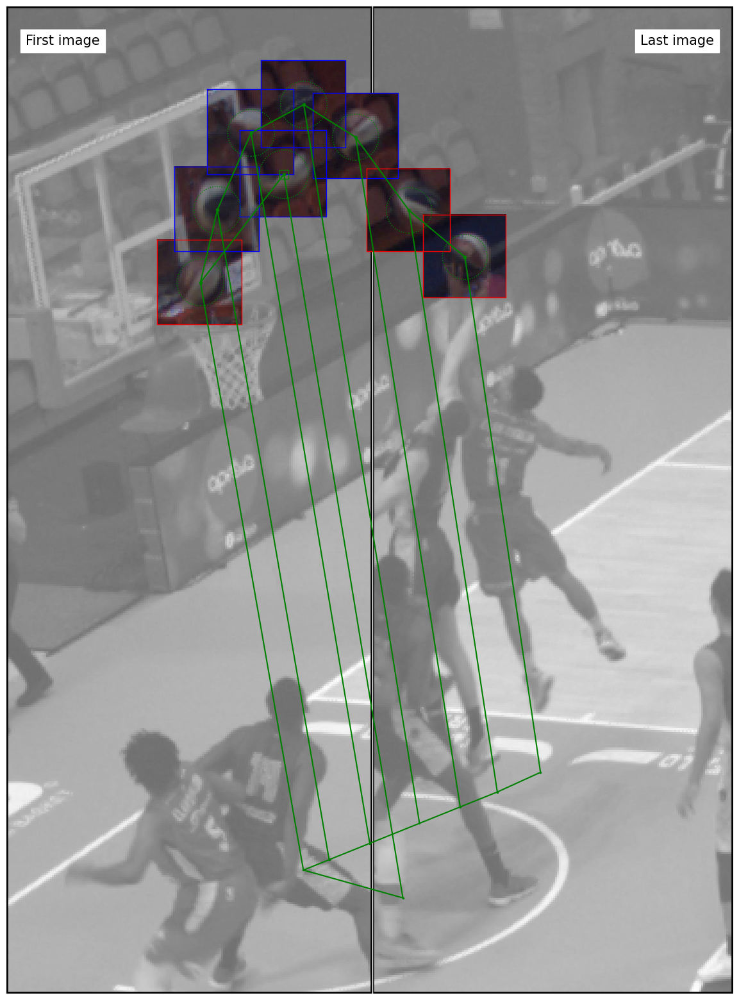

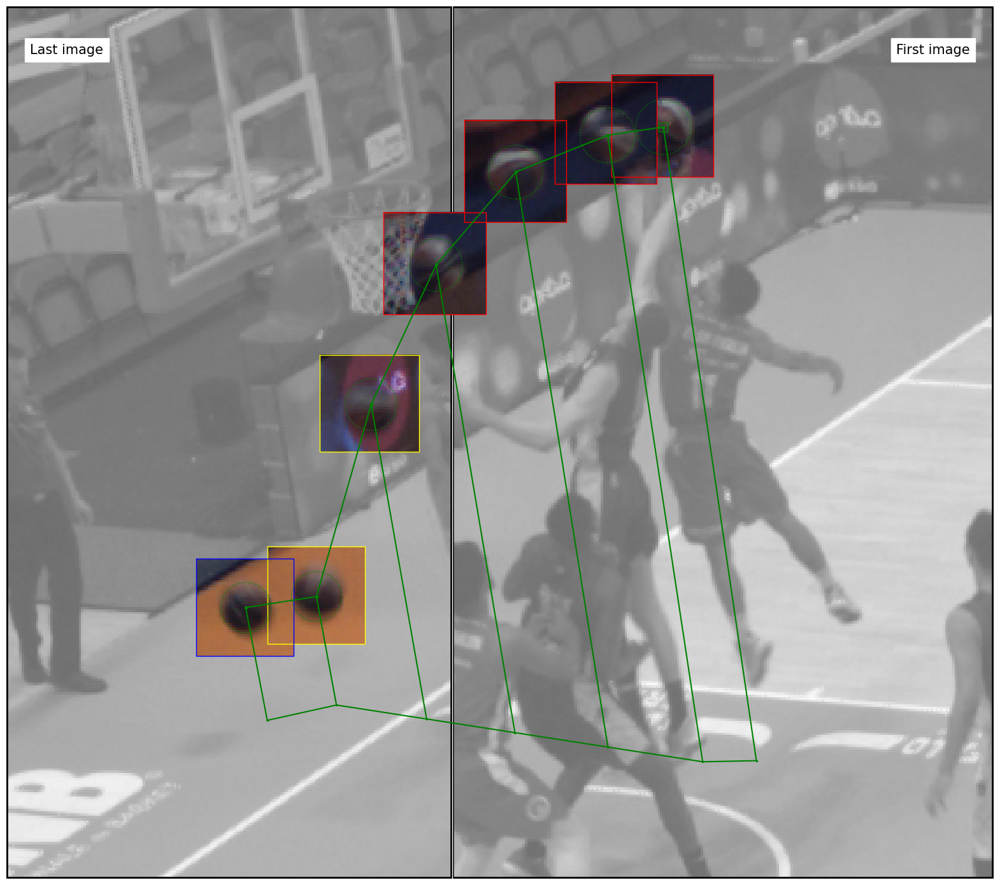

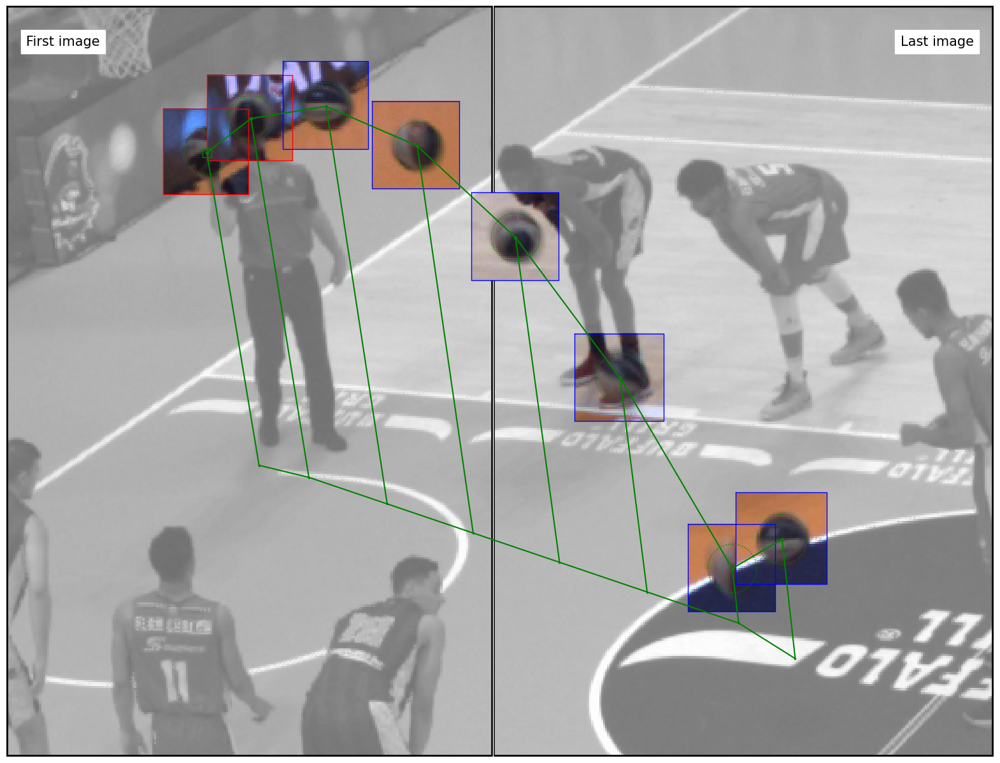

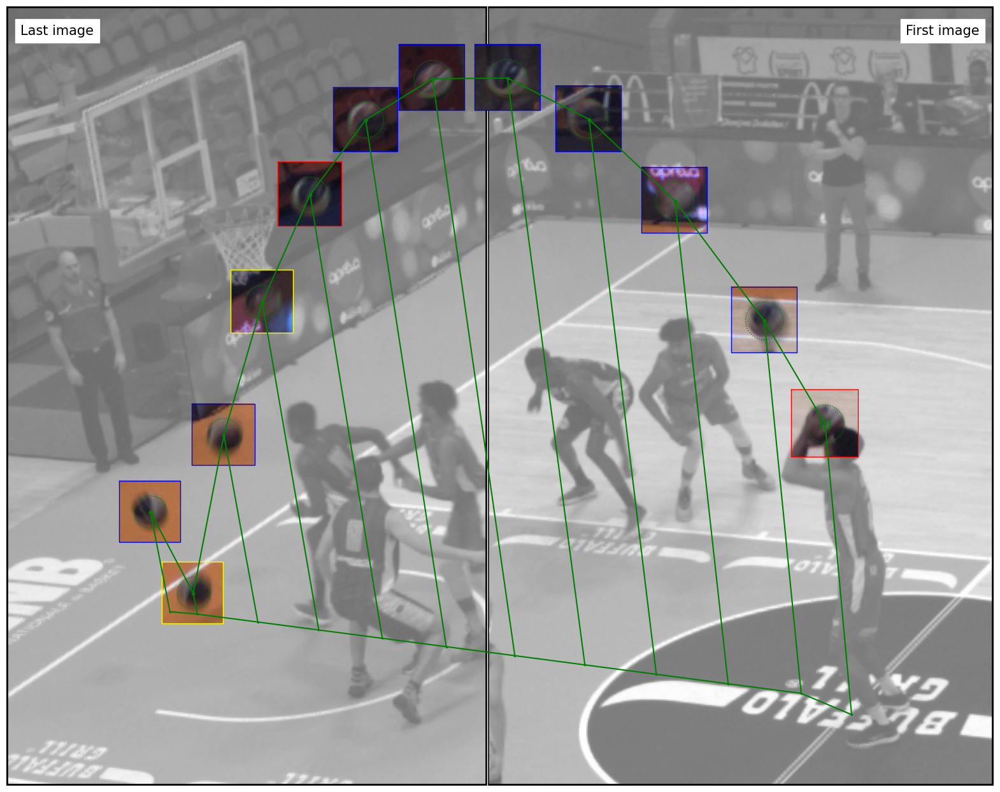

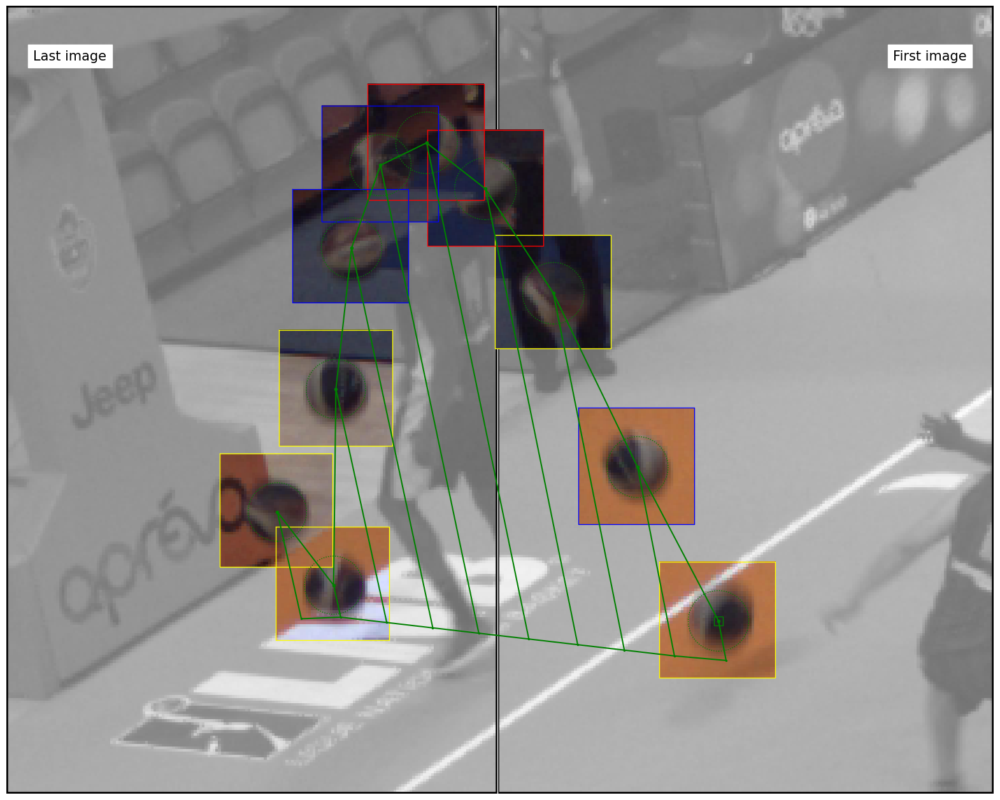

...

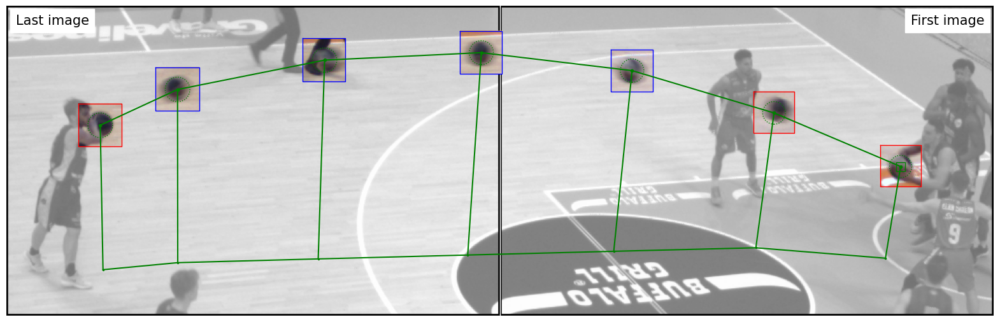

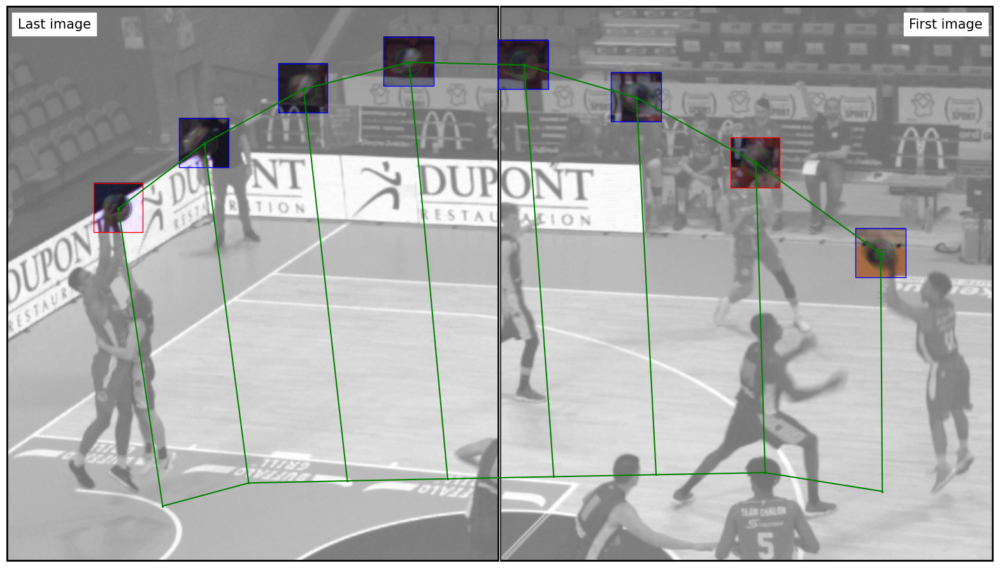

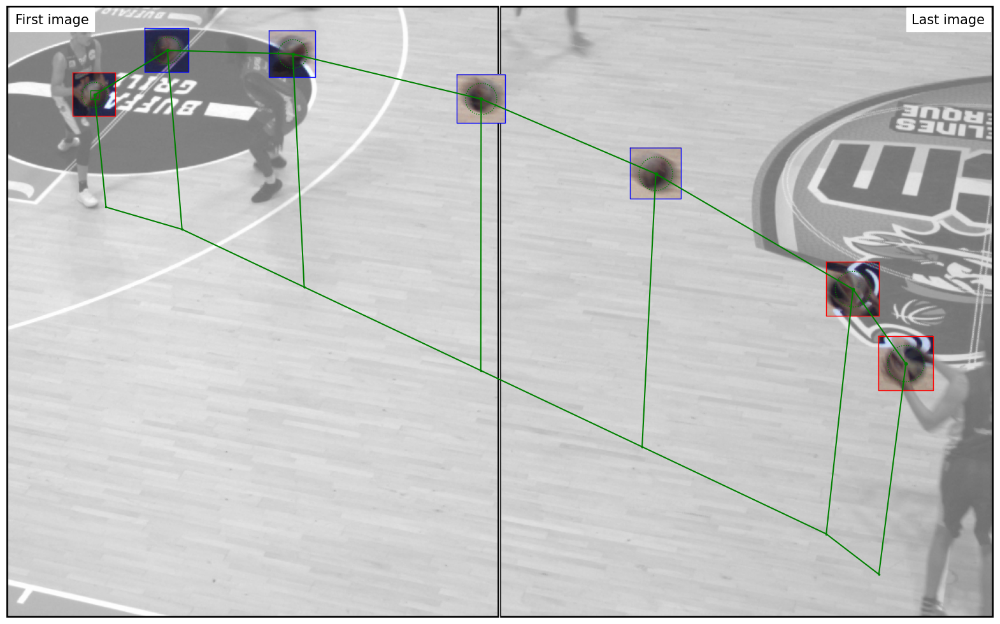

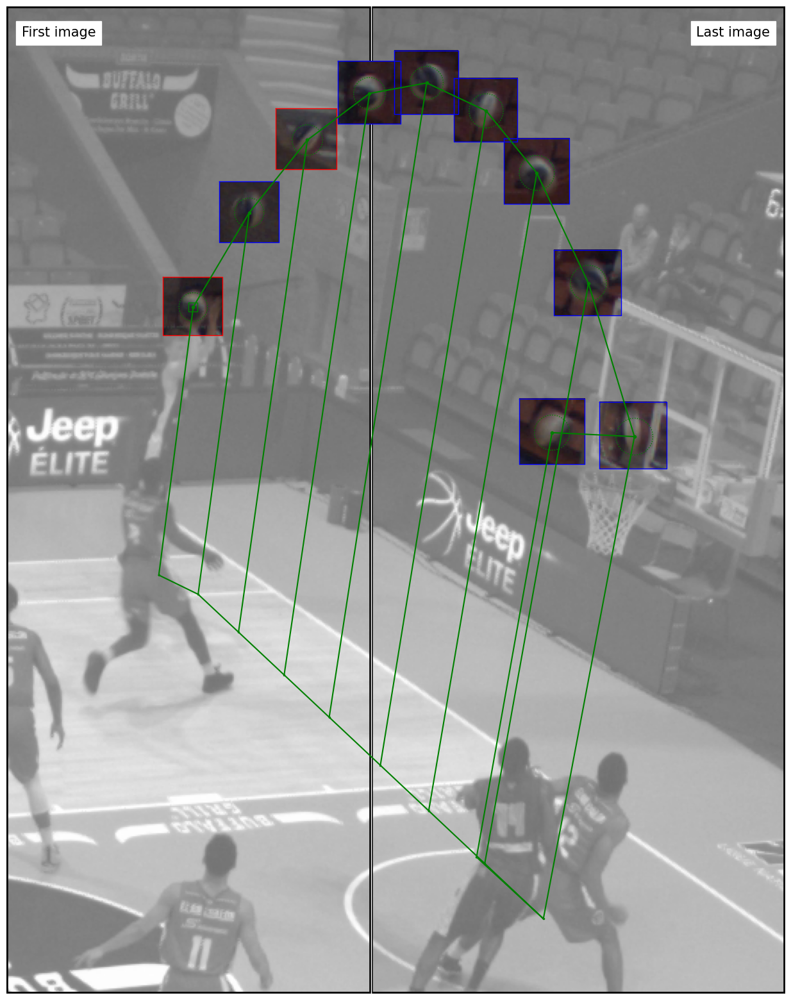

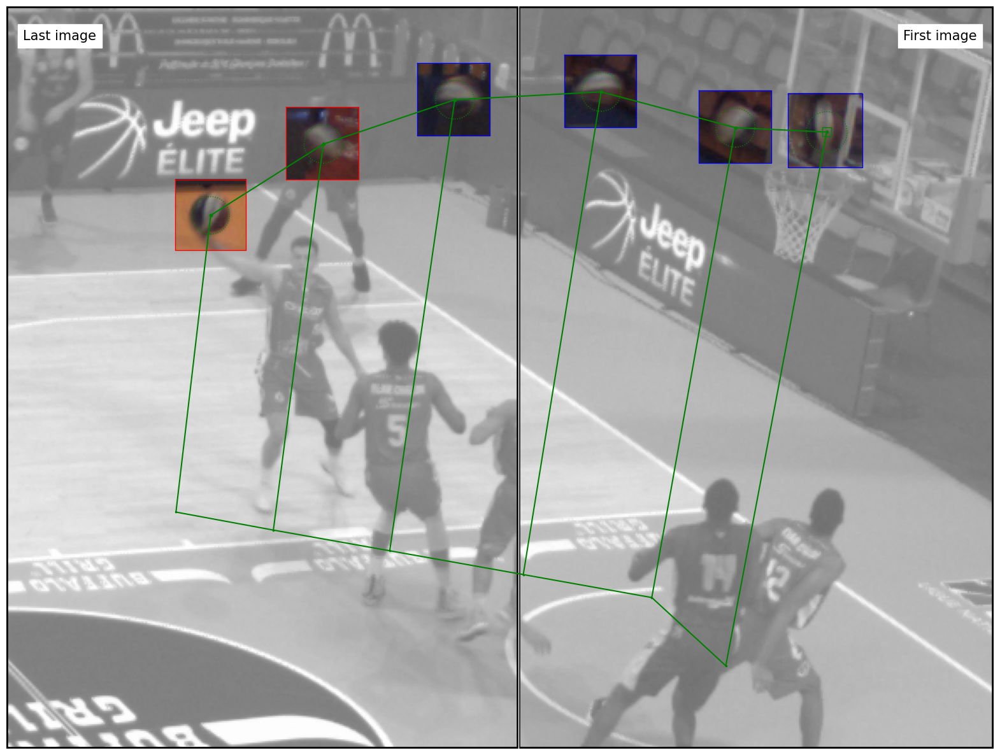

  0%|          | 0/18 [00:00<?, ?it/s]

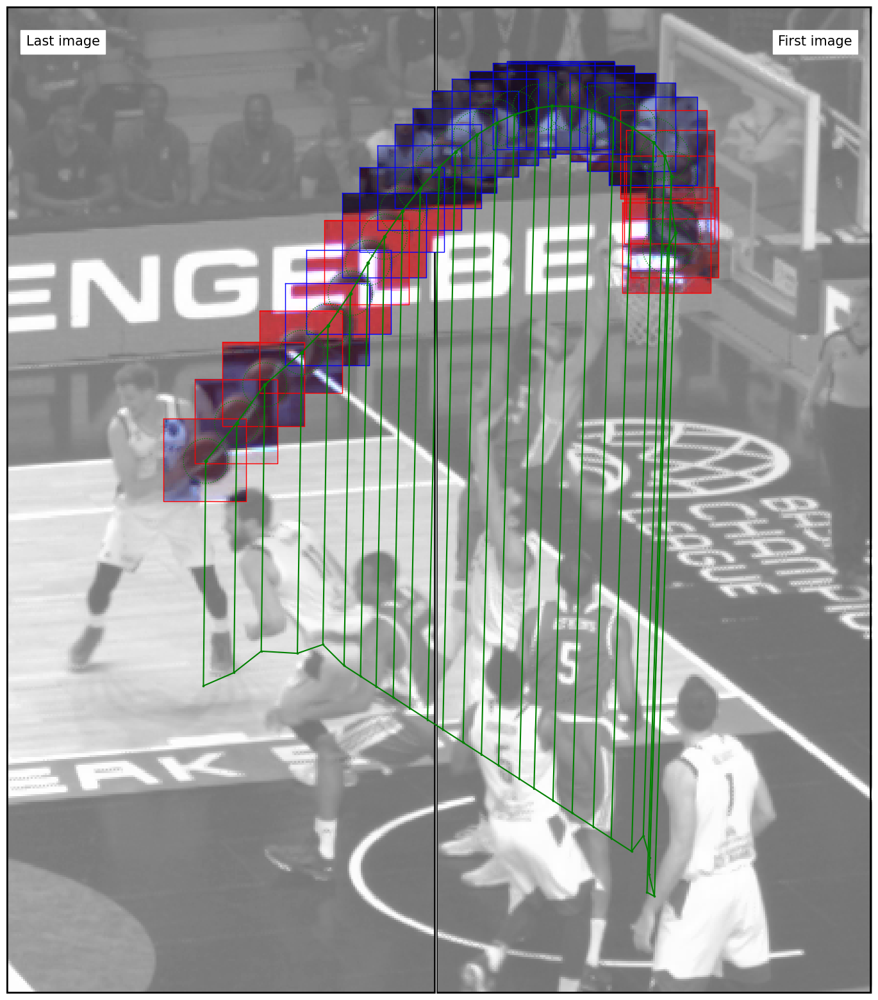

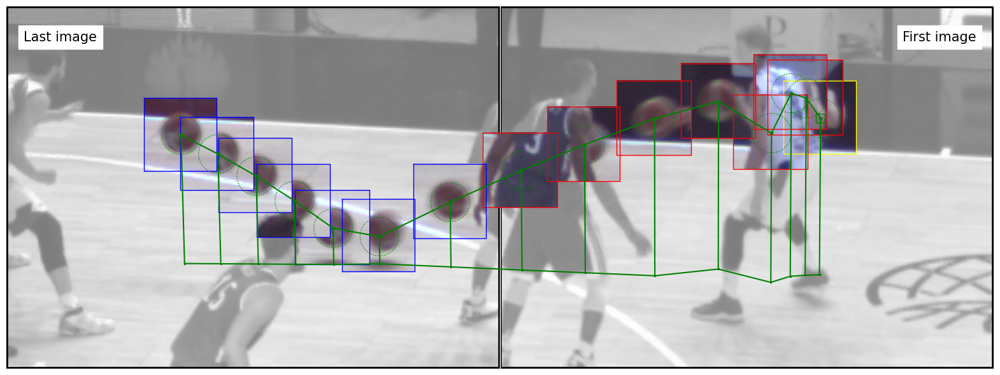

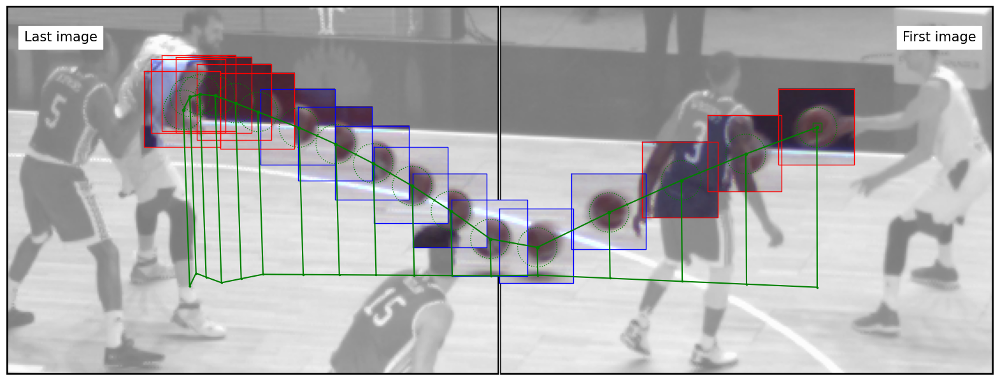

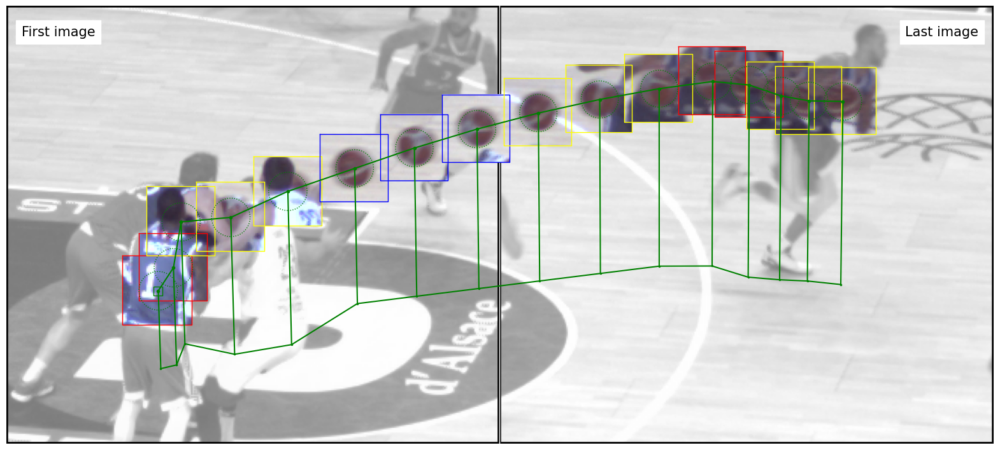

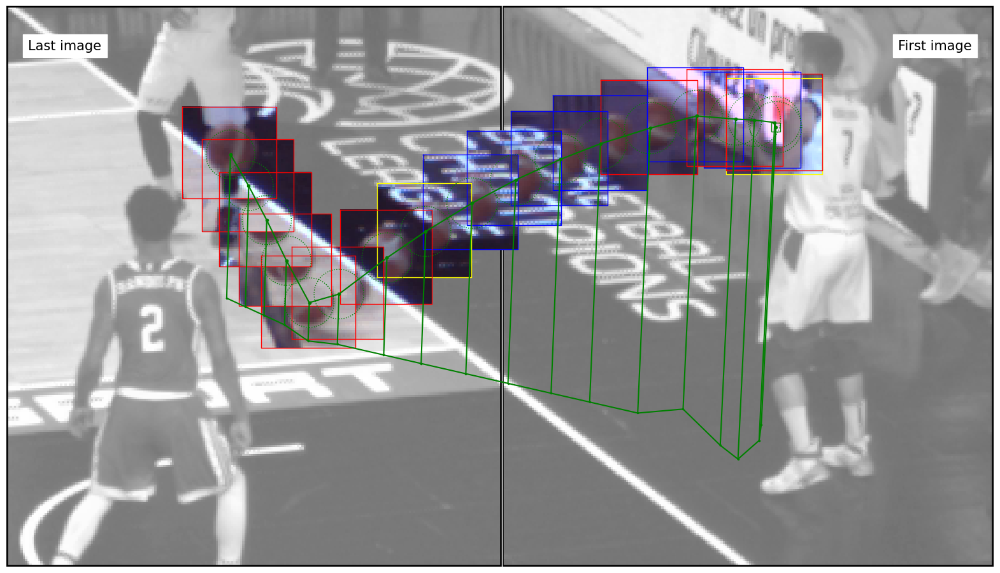

...

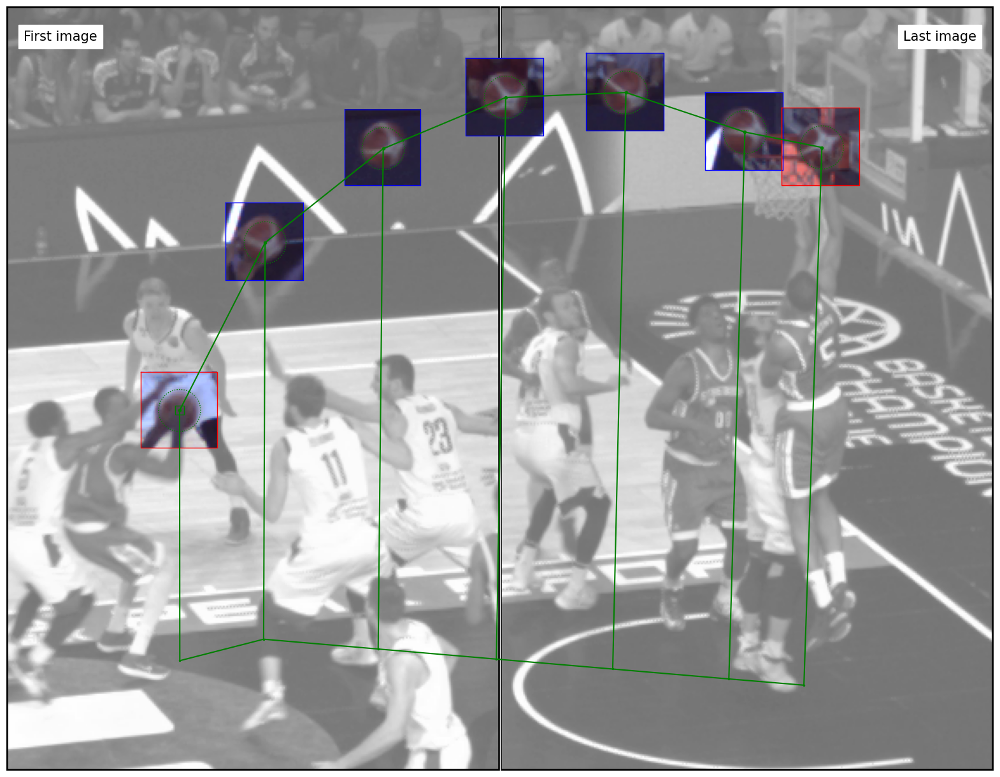

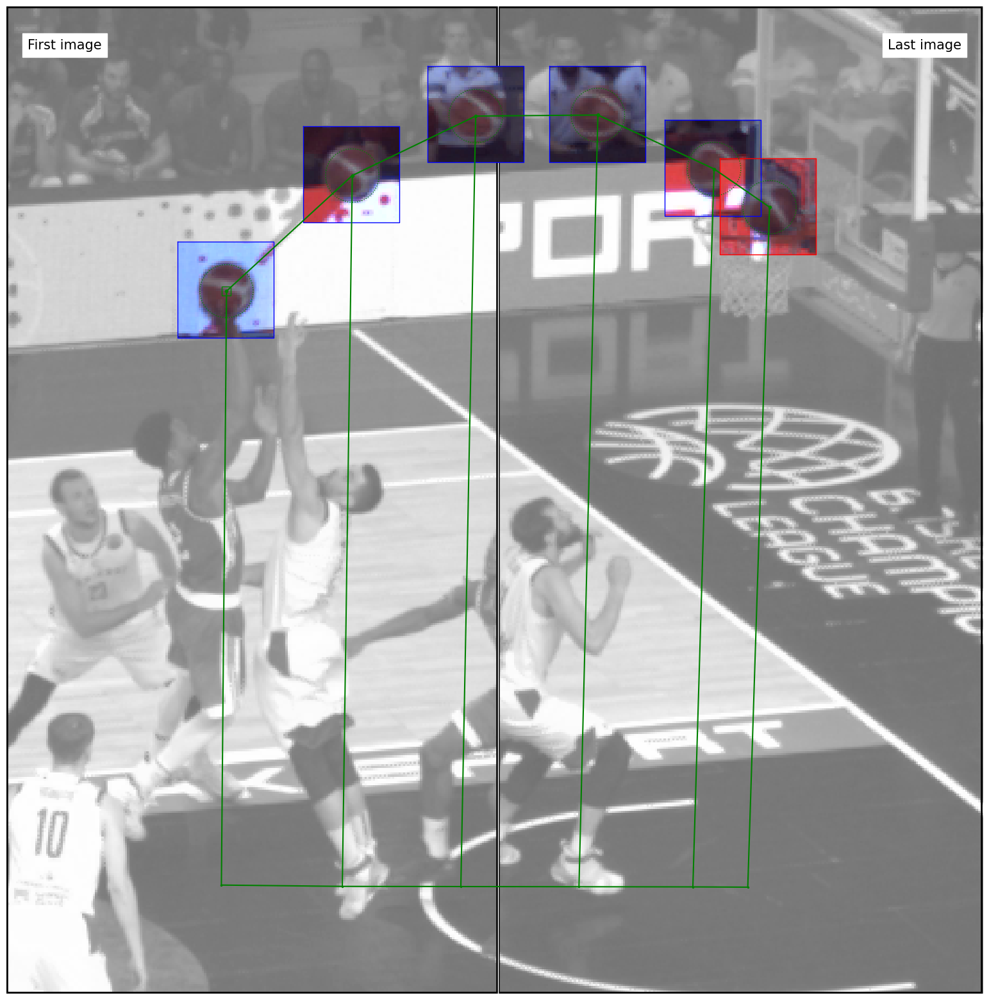

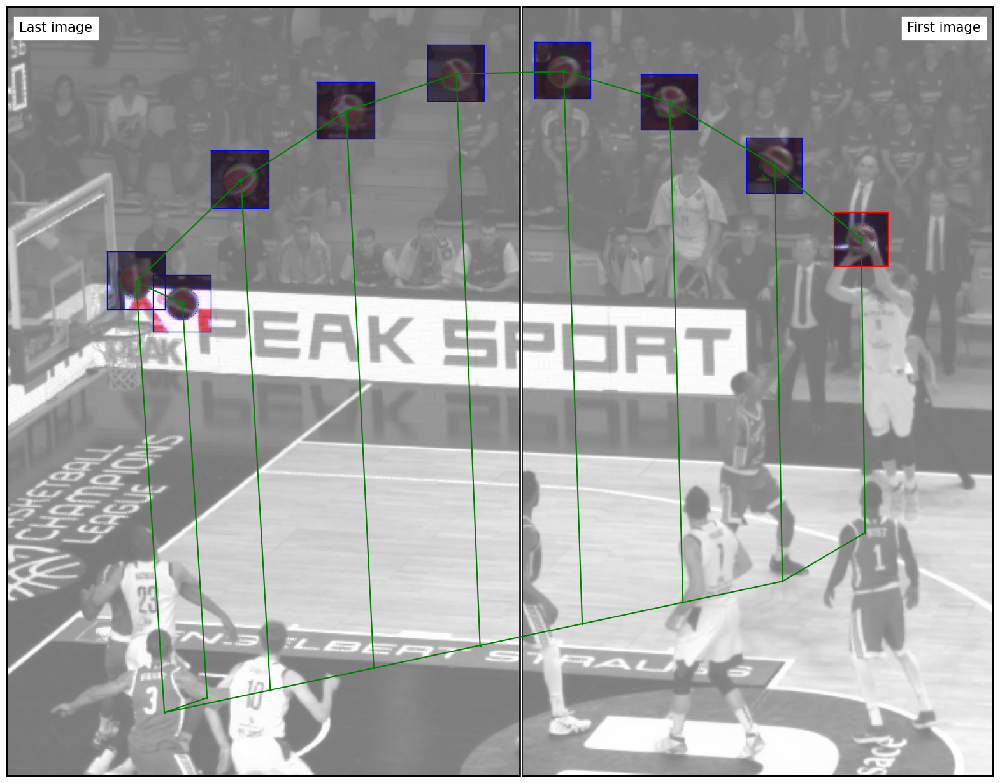

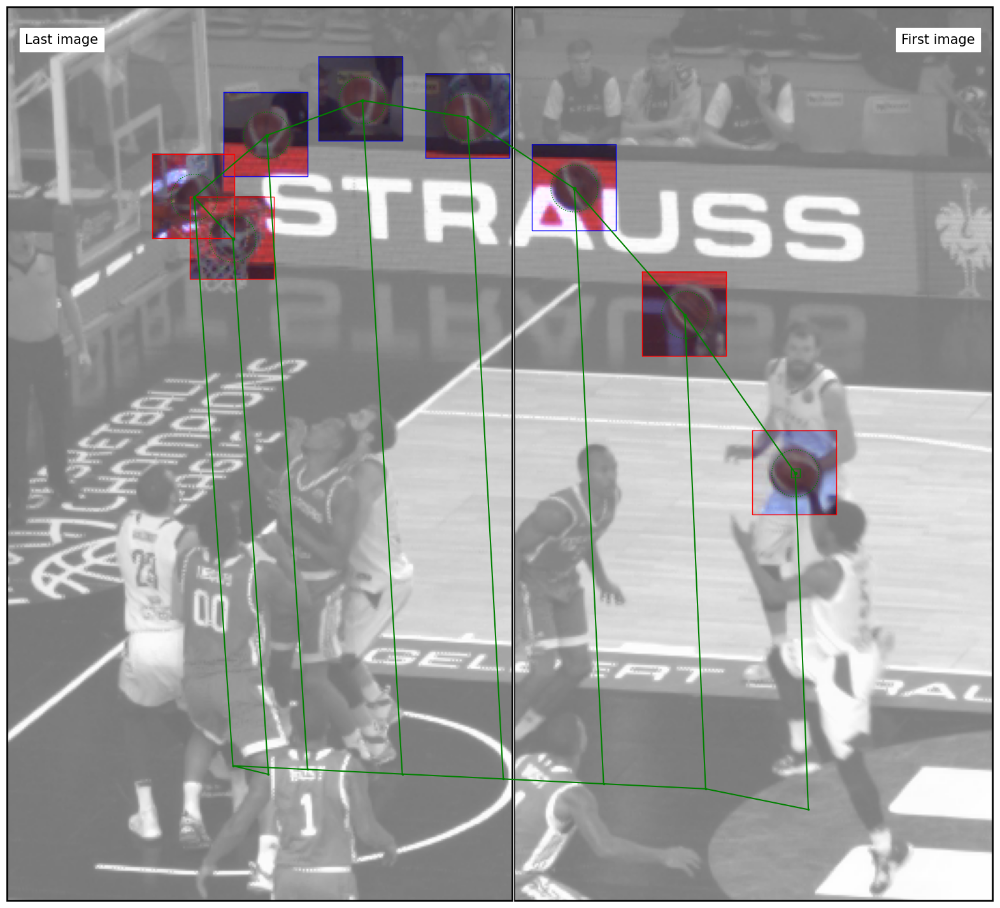

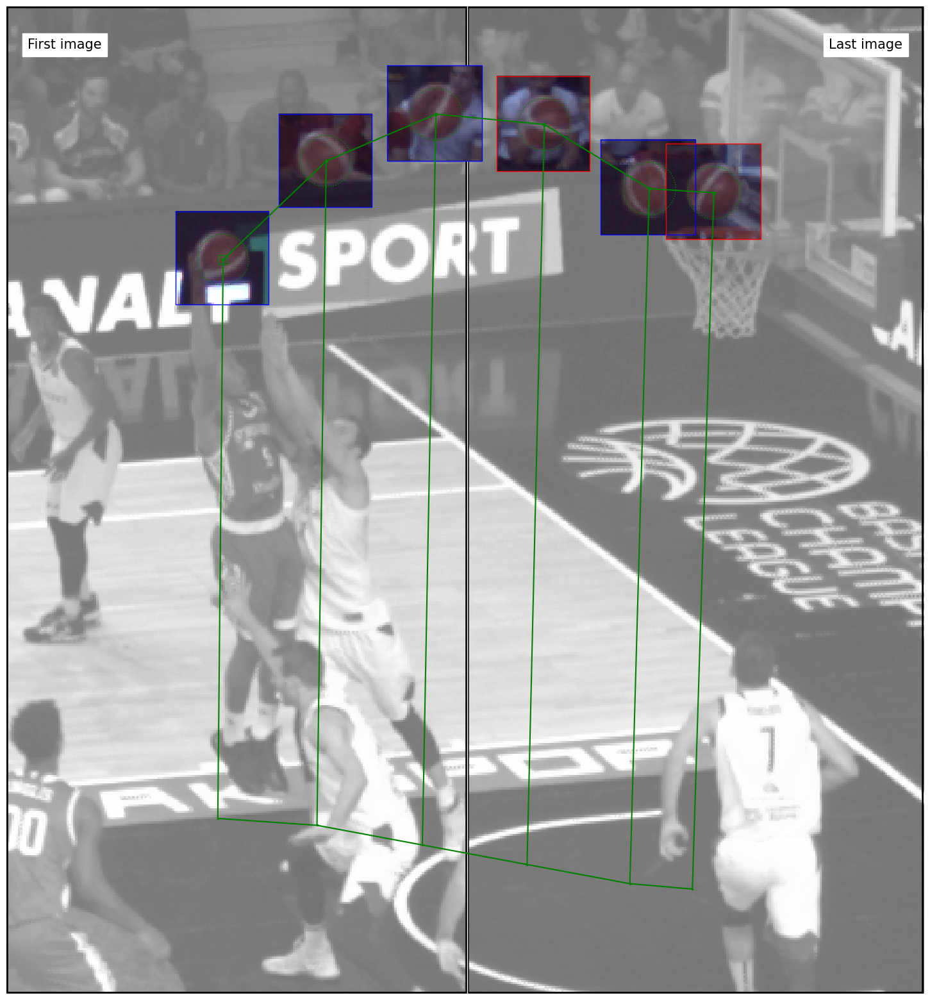

In [64]:
from dataset_utilities.ds.balltracker_dataset import ballistic_trajectories
time_margin = 200 # ms (=2frames)
for (arena_label, game_id), windows in list(ballistic_trajectories.items())[::-1]:
    for t0, t1 in tqdm(windows):
        fig, ax = plt.subplots(1,1, figsize=(20,20))
        cond = lambda key: key.arena_label == arena_label and key.game_id == game_id and t0-time_margin <= key.timestamp <= t1+time_margin
        keys = [key for key in dataset.yield_keys() if cond(key)]
        states = [state for key, state in predicted_states.items() if cond(key)]
        display_ball_sequence(ax, dataset, keys, states=states, declutter=False, grayscale=True)
        plt.show()


In [ ]:
# TODO
# - create 224x224 crops of the raw_sequences_dataset.pickle (from oracle positions)
# - run ballstate to detect flying trajectories
# - measure quality of trajectories extraction
# - run ballsize to measure 3D and compare with GT
# - use trajectories to filter 3D and compare with GT
